In [1]:
from google.colab import drive
drive.mount('gdrive')

Mounted at gdrive


In [2]:
%%capture
!git clone https://github.com/yolandalalala/deepgd.git
!mv deepgd/* .
!gsutil cp gs://chuhanfeng-public/data.zip data.zip
!unzip data.zip
!gsutil cp gs://chuhanfeng-public/deepgd-pickles.zip .
!unzip deepgd-pickles.zip
!mkdir logs

In [2]:
# %%capture
# !apt update
# !apt install python3-dev graphviz libgraphviz-dev pkg-config
# !pip install pygraphviz
!pip uninstall -y torch-scatter
!pip uninstall -y torch-sparse 
!pip uninstall -y torch-cluster
!pip uninstall -y torch-spline-conv
!pip install --no-index torch-scatter -f https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
!pip install --no-index torch-sparse -f https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
!pip install --no-index torch-cluster -f https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
!pip install --no-index torch-spline-conv -f https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
!pip install -U torch-geometric bentley_ottmann ipynb pytorch_lightning

Found existing installation: torch-scatter 2.0.5
Uninstalling torch-scatter-2.0.5:
  Successfully uninstalled torch-scatter-2.0.5
Found existing installation: torch-sparse 0.6.8
Uninstalling torch-sparse-0.6.8:
  Successfully uninstalled torch-sparse-0.6.8
Found existing installation: torch-cluster 1.5.8
Uninstalling torch-cluster-1.5.8:
  Successfully uninstalled torch-cluster-1.5.8
Found existing installation: torch-spline-conv 1.2.1
Uninstalling torch-spline-conv-1.2.1:
  Successfully uninstalled torch-spline-conv-1.2.1
Looking in links: https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
     |████████████████████████████████| 12.0 MB 5.7 MB/s eta 0:00:01
Looking in links: https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
     |████████████████████████████████| 24.3 MB 5.7 MB/s eta 0:00:01
Looking in links: https://pytorch-geometric.com/whl/torch-1.7.0+cu102.html
     |████████████████████████████████| 21.5 MB 5.4 MB/s eta 0:00:01
Looking in links: https://pytorch-geome

In [1]:
!nvidia-smi

Tue Feb 23 13:05:48 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 440.64.00    CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   75C    P0    34W /  70W |    800MiB / 15109MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [1]:
%load_ext autoreload
%autoreload 2

## **[edge attr]** *euclidean and normalized direction* 
## **[edge net]** *2 layers*
## **[block dim]** *8,8,8,8*
## **[num blocks]** *9*
## **[edges]** full
## **[pivots]** N/A
## **[edge weight]** $\frac{1}{d^2}$
## **[init pos]** *scaled PMDS*
## **[loss]** *StressLoss:1*
## **[loss controller]** *FixedWeightController*
## **[data]** *rome*

In [2]:
from lib.imports import *
from lib.functions import *
from lib.utils import *
from lib.modules import *
from lib.data import *
from ipynb.fs.defs.losses import *

# Config

In [3]:
cuda_idx = 0
config = StaticConfig({
    "name": "l={stress:1},edge=full,w=reg,data=rome,init=pmds",
    "pretrained": {
        "name": None,
        "epoch": -1
    },
    "batchsize": 128,
    "epoch": {
        "start": -1,
        "end": None
    },
    "lr" : {
        "initial": 0.01,
        "decay_rate": 0.99,
        "decay_step": 1,
        "override": {
            "start_epoch": None,
            "target_lr": None,
            "decay_rate": None,
            "decay_step": None
        }
    },
    "log_period": 1,
    "test": {
        "name": "test",
        "epoch": -1
    }
})
data_config = StaticConfig({
    "sparse": False,
    "pivot": None,
    "init": 'pmds',
    "edge": {
        "index": "full_edge_index",
        "attr": "full_edge_attr"
    }
})
loss_fns = {
    StressLoss(): 1
}
model_params = {
    "num_blocks": 9
}
ctrler_params = {
    "tau": 0.95,
    "beta": 1,
    "exploit_rate": 0.5,
    "warmup": 2
}

In [4]:
config[...]

{'name': 'l={stress:1},edge=full,w=reg,data=rome,init=pmds',
 'pretrained': {'name': None, 'epoch': -1},
 'batchsize': 128,
 'epoch': {'start': -1, 'end': None},
 'lr': {'initial': 0.01,
  'decay_rate': 0.99,
  'decay_step': 1,
  'override': {'start_epoch': None,
   'target_lr': None,
   'decay_rate': None,
   'decay_step': None}},
 'log_period': 1,
 'test': {'name': 'test', 'epoch': -1}}

In [5]:
root = '.'
ckpt_folder = lambda: f"{root}/ckpts/{config.name}"
pretrain_folder = lambda: f"{root}/checkpoints/{config.pretrained.name}"
tb_folder = lambda: f"{root}/tensorboards/{config.name}"
vis_folder = lambda: f'{root}/visualizations/{config.name}_{config.test.name}'
log_file = lambda: f"{root}/logs/{config.name}.log"
metrics_file = lambda suffix: f"{root}/metrics/{config.name}_{suffix}.pickle"

In [6]:
print(f"cd {os.getcwd()}")
print(f"tail -f '{log_file()}'")

cd /home/jupyter/deepgd
tail -f './logs/l={stress:1},edge=full,w=reg,data=rome,init=pmds.log'


In [7]:
if cuda_idx is not None and torch.cuda.is_available():
    device = f'cuda:{cuda_idx}'
    nvidia_smi.nvmlInit()
    cuda = nvidia_smi.nvmlDeviceGetHandleByIndex(cuda_idx)
else:
    device = 'cpu'
    cuda =  None
np.set_printoptions(precision=2)
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [8]:
G_list = load_G_list(data_path='data/rome', index_file='data_index.txt', cache='G_list.pickle')
data_list = generate_data_list(G_list, 
                               sparse=data_config.sparse, 
                               pivot_mode=data_config.pivot,
                               init_mode=data_config.init,
                               edge_index=data_config.edge.index,
                               edge_attr=data_config.edge.attr,
                               pmds_list=pickle.load(open('pmds_list.pickle', 'rb')),
                               device='cpu', 
                               cache='data_list_pmds.pickle')
train_loader = LazyDeviceMappingDataLoader(data_list[:10000], batch_size=config.batchsize, shuffle=True, device=device)
val_loader = LazyDeviceMappingDataLoader(data_list[11000:], batch_size=config.batchsize, shuffle=False, device=device)

In [9]:
def mkdirs(*folders):
    for folder in folders:
        if not os.path.isdir(folder):
            os.makedirs(folder)

In [10]:
def lr_lambda(epoch):
    current_epoch = config.epoch.start + epoch
    if config.lr.override.start_epoch is not None and current_epoch >= config.lr.override.start_epoch:
        num_step = (current_epoch - config.lr.override.start_epoch) // config.lr.override.decay_step
        return config.lr.override.target_lr * config.lr.override.decay_rate ** num_step
    num_step = current_epoch // config.lr.decay_step
    return config.lr.initial * config.lr.decay_rate ** num_step

In [11]:
def train_callback(*, output, loss, components):
    postfix = {'loss': loss.item()}
    if cuda is not None:
        util_info = nvidia_smi.nvmlDeviceGetUtilizationRates(cuda)
        mem_info = nvidia_smi.nvmlDeviceGetMemoryInfo(cuda)
        postfix['gpu%'] = util_info.gpu
        postfix['mem%'] = mem_info.used / mem_info.total * 100
    progress.update()
    progress.set_postfix(postfix)

In [12]:
def test_callback(*, idx, pred, metrics):
    graph_vis(G_list[idx], pred, f"{vis_folder()}/{idx}_{metrics['stress']:.2f}_{metrics['resolution_score']:.2f}.png")

In [13]:
def get_ckpt_epoch(folder, epoch):
    if not os.path.isdir(folder):
        os.mkdir(folder)
    if epoch >= 0:
        return epoch
    ckpt_files = os.listdir(folder)
    last_epoch = 0
    if ckpt_files:
        last_epoch = sorted(list(map(lambda x: int(re.search('(?<=epoch_)(\d+)(?=\.)', x).group(1)), ckpt_files)))[-1]
    return last_epoch + epoch + 1

In [14]:
mkdirs(ckpt_folder(), tb_folder(), vis_folder(), f"{root}/logs", f"{root}/metrics")

In [15]:
model = Model(**model_params).to(device)
start_epoch = get_ckpt_epoch(ckpt_folder(), config.epoch.start)
ckpt_file = None
if start_epoch != 0:
    ckpt_file = f"{ckpt_folder()}/epoch_{start_epoch}.pt"
elif config.pretrained.name is not None and config.pretrained.epoch != 0:
    pretrained_epoch = get_ckpt_epoch(pretrain_folder(), config.pretrained.epoch)
    ckpt_file = f"{pretrain_folder()}/epoch_{pretrained_epoch}.pt"
if ckpt_file is not None:
    print(f"Loading from {ckpt_file}...")
    state_dict = torch.load(ckpt_file, map_location=torch.device(device))
    model.load_state_dict(state_dict)

Loading from ./ckpts/l={stress:1},edge=full,w=reg,data=rome,init=pmds/epoch_502.pt...


In [20]:
criterion = CompositeLoss(list(loss_fns.keys()))
controller = FixedWeightController(criterion, gamma=list(loss_fns.values()), **ctrler_params)
optimizer = torch.optim.AdamW(model.parameters(), lr=1)
scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer=optimizer, lr_lambda=lr_lambda)
tensorboard = SummaryWriter(log_dir=tb_folder())
epoch = start_epoch + 1

In [ ]:
print("=" * 100, file=open(log_file(), "a"))
progress = tqdm(total=len(train_loader), smoothing=0)
while True:
    progress.reset()
    progress.set_description(desc=f"[epoch {epoch}/{config.epoch.end}]")
    train_loss, train_loss_comp = train(model=model, 
                                        criterion=criterion, 
                                        optimizer=optimizer,
                                        data_loader=train_loader, 
                                        callback=train_callback)
    controller.step(train_loss_comp)
    scheduler.step()
    if epoch % config.log_period == 0:
        torch.save(model.state_dict(), f"{ckpt_folder()}/epoch_{epoch}.pt")
        val_loss, val_loss_comp = validate(model=model, 
                                           criterion=criterion,
                                           data_loader=val_loader)
        tensorboard.add_scalars('loss', {'train': train_loss, 
                                         'validation': val_loss}, epoch)
        for i, fn in enumerate(loss_fns):
            tensorboard.add_scalars(type(fn).__name__, {'train': train_loss_comp[i].item(), 
                                                  'validation': val_loss_comp[i].item()}, epoch)
        info = {
            'train':   f'train: {train_loss:.2f} {train_loss_comp}',
            'val':     f'val: {val_loss:.2f} {val_loss_comp}',
            'weights': f'weights: {controller.get_last_weights()}',
            'policy':  f'policy: {controller.get_last_policy()}',
            'lr':      f'lr: {scheduler.get_last_lr()[0]:.2e}',
        }
        print(f"[{epoch:03}] {info['train']}, {info['val']}, {info['weights']}, {info['policy']}, {info['lr']}",
              file=open(log_file(), "a"))
    if epoch == config.epoch.end:
        break
    epoch += 1

Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration finished. 0 out of 5 failed!
Iteration finished. 0 out of 79 failed!
Iteration fi

In [ ]:
ckpt_epoch = get_ckpt_epoch(ckpt_folder(), config.test.epoch)
ckpt_file = f'{ckpt_folder()}/epoch_{ckpt_epoch}.pt'
print(f'Loading checkpoint from {ckpt_file}')
state_dict = torch.load(ckpt_file, map_location=torch.device(device))
model = Model(**model_params).to(device)
model.load_state_dict(state_dict)

In [ ]:
if os.path.isdir(vis_folder()):
    shutil.rmtree(vis_folder())
os.mkdir(vis_folder())

In [19]:
evaluation_criteria = []

  1%|          | 8/1000 [00:15<32:17,  1.95s/it]/opt/conda/lib/python3.7/site-packages/umap/umap_.py:1674: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  "n_neighbors is larger than the dataset size; truncating to "
  1%|          | 10/1000 [00:18<30:50,  1.87s/it]/opt/conda/lib/python3.7/site-packages/umap/umap_.py:1674: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  "n_neighbors is larger than the dataset size; truncating to "
  1%|▏         | 13/1000 [00:24<33:10,  2.02s/it]/opt/conda/lib/python3.7/site-packages/umap/umap_.py:1674: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  "n_neighbors is larger than the dataset size; truncating to "
  2%|▎         | 25/1000 [00:48<35:20,  2.17s/it]/opt/conda/lib/python3.7/site-packages/umap/umap_.py:1674: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  "n_neighbors is larger than

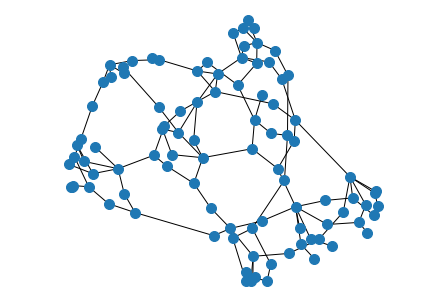

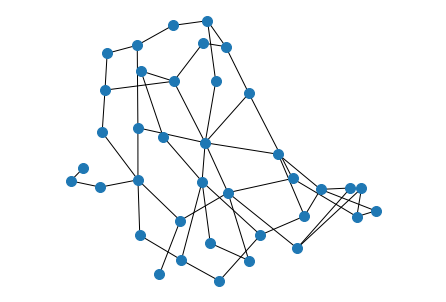

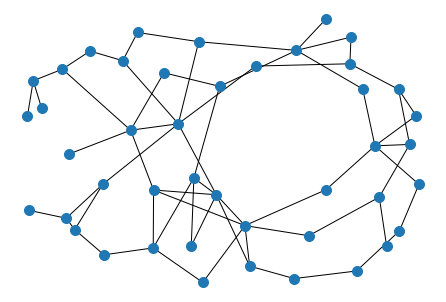

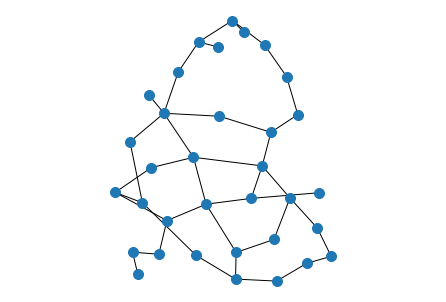

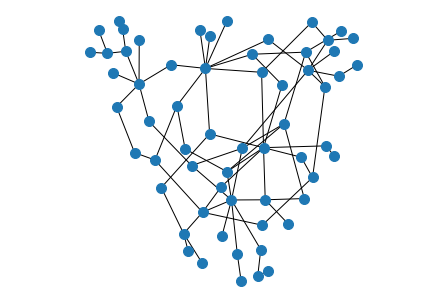

...

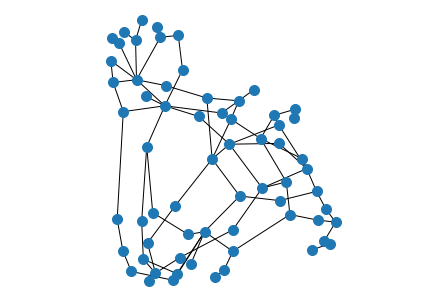

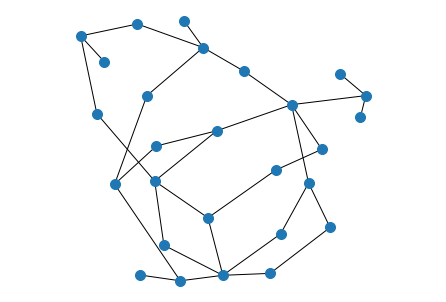

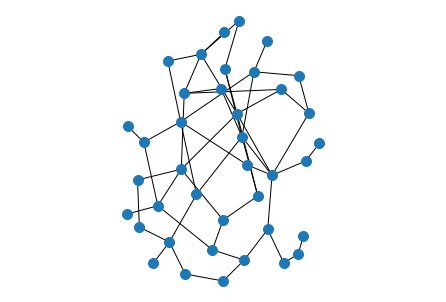

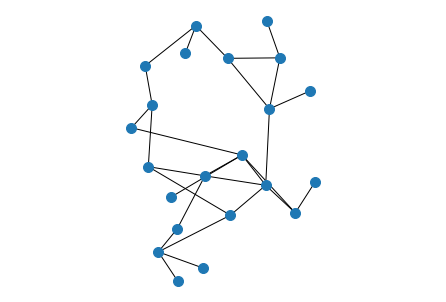

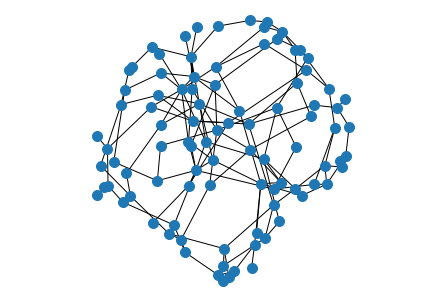

In [20]:
test_metrics = test(model=model, 
                    criteria_list=evaluation_criteria, 
                    dataset=data_list, 
                    idx_range=range(10000, 11000), 
                    callback=test_callback,
                    eval_method='umap')
pickle.dump(test_metrics, open(metrics_file("test"), "wb"))

In [21]:
metrics = test_metrics
print('stress:', metrics['stress'].mean())
print('stress_spc:', metrics['stress_spc'].mean())
print('l1_angle:', metrics['l1_angle'].mean())
print('l1_angle_spc:', metrics['l1_angle_spc'].mean())
print('edge:', metrics['edge'].mean())
print('edge_spc:', metrics['edge_spc'].mean())
print('ring:', metrics['ring'].mean())
print('ring_spc:', metrics['ring_spc'].mean())
print('tsne:', metrics['tsne'].mean())
print('reso_score:', metrics['resolution_score'].mean())
print('min_angle:', metrics['min_angle'].mean())

stress: tensor(379.8806)
stress_spc: tensor(0.4140)
l1_angle: tensor(94.2529)
l1_angle_spc: tensor(0.1710)
edge: tensor(0.2528)
edge_spc: tensor(0.6530)
ring: tensor(257.6293)
ring_spc: tensor(0.1469)
tsne: tensor(0.1939)
reso_score: tensor(0.5416)
min_angle: tensor(6.0767)


In [23]:
pickle.dump(metrics, open('umap_metrics.pickle', 'wb'))

In [24]:
gt = pd.DataFrame()
gt['stress'] = metrics['stress']
gt['l1_angle'] = metrics['l1_angle']
gt['edge'] = metrics['edge']
gt['ring'] = metrics['ring']
gt['tsne'] = metrics['tsne']
gt['index'] = range(10000, 11000)
gt

,stress,l1_angle,edge,ring,tsne,index
0,1004.787048,154.598755,0.268346,470.934448,0.299810,10000
1,152.222137,85.616013,0.181134,157.557739,0.190572,10001
2,166.891220,82.523148,0.157688,169.799545,0.163467,10002
3,87.603394,46.508034,0.173523,84.256310,0.108892,10003
4,416.753906,86.790489,0.272091,320.612366,0.216509,10004
...,...,...,...,...,...,...
995,486.092377,101.075180,0.308011,322.342529,0.247253,10995
996,66.215065,42.066040,0.179158,75.855408,0.132767,10996
997,187.797943,74.973572,0.243932,168.836151,0.190865,10997
998,47.111950,40.025558,0.229250,56.941483,0.109833,10998


In [25]:
gt.to_csv('gt_umap.csv', index=False)